<a href="https://colab.research.google.com/github/GiX7000/deep-learning-with-tensorflow/blob/main/Part9.activation%26saliency-maps-GradCAMs.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Deep Learning with TensorFlow with Laurence Moroney, Part9

## Exampe 1. A very basic Class Activation Map with Fashion MNIST Dataset.

A class activation map is a matrix that shows what parts of the image the model was paying attention to when deciding what class to assign the image. It's a map of which pixels of the image sent activations that we use to determine the class of the object.

We will see how to implement a simple class activation map (CAM) of a model trained on the Fashion MNIST dataset. This will show what parts of the image the model was paying attention to when deciding the class of the image.

In [ ]:
import keras
from keras.datasets import fashion_mnist
import numpy as np
import matplotlib.pyplot as plt
from keras.models import Sequential, Model
from keras.layers import Dense, Conv2D, MaxPooling2D, GlobalAveragePooling2D
import scipy as sp

In [ ]:
# load the Fashion MNIST dataset
(X_train, Y_train), (X_test, Y_test) = fashion_mnist.load_data()

4422102/4422102 [==============================] - 0s 0us/step


In [ ]:
# check data shapes
len(X_train), len(X_test)

(60000, 10000)

In [ ]:
# Put an additional axis for the channels of the image.
# Fashion MNIST is grayscale so we place 1 at the end. Other datasets 
# will need 3 if it's in RGB
X_train = X_train.reshape(len(X_train), 28, 28, 1)
X_test  = X_test.reshape(len(X_test), 28, 28, 1)

# Normalize the pixel values from 0 to 1
X_train = X_train/255
X_test  = X_test/255

# Cast to float
X_train = X_train.astype("float")
X_test  = X_test.astype("float")

In [ ]:
def show_img(img):
  """Utility function for reshaping and displaying an image"""

  # Convert to float array if img is not yet preprocessed
  img = np.array(img, dtype="float")

  # remove channel dimension
  img = img.reshape((28, 28))

  # display image
  plt.imshow(img)

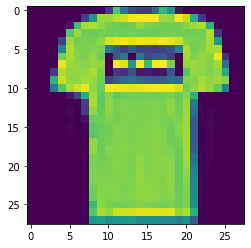

In [ ]:
# test the function for the first train image
show_img(X_train[1])

In [ ]:
# define a simple model

# use the Sequential API
model = Sequential()

# notice the padding parameter to recover the lost border pixels when doing the convolution
model.add(Conv2D(16, input_shape=(28, 28, 1), kernel_size=(3, 3), activation="relu", padding="same"))
# pooling layer with a stride of 2 will reduce the image dimensions by half
model.add(MaxPooling2D(pool_size=(2, 2)))

# pass through more convolutions with increasing filters
model.add(Conv2D(32, kernel_size=(3, 3), activation="relu", padding="same"))
model.add(MaxPooling2D(pool_size=(2 ,2)))

model.add(Conv2D(64, kernel_size=(3, 3), activation="relu", padding="same"))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(128, kernel_size=(3, 3), activation="relu", padding="same"))

# use global average pooling to take into account lesser intensity pixels
model.add(GlobalAveragePooling2D())

# output class probabilities
model.add(Dense(10, activation="softmax"))

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_13 (Conv2D)          (None, 28, 28, 16)        160       
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 14, 14, 16)       0         
 2D)                                                             
                                                                 
 conv2d_14 (Conv2D)          (None, 14, 14, 32)        4640      
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 7, 7, 32)         0         
 2D)                                                             
                                                                 
 conv2d_15 (Conv2D)          (None, 7, 7, 64)          18496     
                                                                 
 max_pooling2d_7 (MaxPooling  (None, 3, 3, 64)         0

In [ ]:
# configure the training
model.compile(loss="sparse_categorical_crossentropy",
              metrics=["accuracy"],
              optimizer="adam")

# train the model. just run a few epochs for this test run
model.fit(X_train, Y_train,
          batch_size=32,
          epochs=5,
          validation_split=0.1,
          shuffle=True)

Epoch 1/5
1688/1688 [==============================] - 17s 9ms/step - loss: 0.5978 - accuracy: 0.7807 - val_loss: 0.3963 - val_accuracy: 0.8550
Epoch 2/5
1688/1688 [==============================] - 15s 9ms/step - loss: 0.3717 - accuracy: 0.8656 - val_loss: 0.3376 - val_accuracy: 0.8767
Epoch 3/5
1688/1688 [==============================] - 18s 11ms/step - loss: 0.3163 - accuracy: 0.8839 - val_loss: 0.3044 - val_accuracy: 0.8820
Epoch 4/5
1688/1688 [==============================] - 12s 7ms/step - loss: 0.2790 - accuracy: 0.8973 - val_loss: 0.2782 - val_accuracy: 0.8977
Epoch 5/5
1688/1688 [==============================] - 19s 11ms/step - loss: 0.2527 - accuracy: 0.9067 - val_loss: 0.2697 - val_accuracy: 0.9028


Generate the Class Activation Map

To generate the class activation map, we want to get the features detected in the last convolution layer and see which ones are most active when generating the output probabilities. In our model above, we are interested in the layers shown below.

In [ ]:
# final convolution layer
print(model.layers[-3].name)

# global average pooling layer
print(model.layers[-2].name)

# output of the classifier
print(model.layers[-1].name)

conv2d_16
global_average_pooling2d
dense


To create our CAM model, we should take 2 outputs: the last conv layer and the last dense(for prediction) layer.

In [ ]:
# same as previous model but with additional output
cam_model = Model(inputs=model.input, outputs=[model.layers[-3].output, model.layers[-1].output])
cam_model.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_13_input (InputLayer  [(None, 28, 28, 1)]      0         
 )                                                               
                                                                 
 conv2d_13 (Conv2D)          (None, 28, 28, 16)        160       
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 14, 14, 16)       0         
 2D)                                                             
                                                                 
 conv2d_14 (Conv2D)          (None, 14, 14, 32)        4640      
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 7, 7, 32)         0         
 2D)                                                             
                                                           

In [ ]:
# Use the CAM model to predict on the test set, so that it generates the features and the predicted probability for each class(results).

# get the features and results of the test images using the newly created model
features, results = cam_model.predict(X_test)

# shape of the features
print("features shape: ", features.shape)
print("results shape:  ", results.shape)

313/313 [==============================] - 1s 5ms/step
features shape:  (10000, 3, 3, 128)
results shape:   (10000, 10)


We can generate the CAM by getting the dot product of the class activation features and the class activation weights.

We will need the weights from the Global Average Pooling layer(GAP), which is after the last conv layer and before the last dense layer, to calculate the activations of each feature given a particular class.

In [ ]:
# For each of the 10 classes, there are 128 features, so there are 128 feature weights, one weight per feature

# these are the weights going into the softmax layer
last_dense_layer = model.layers[-1]

# get the weights list. Index 0 contains the weights, index 1 contains the biases
gap_weights_list = last_dense_layer.get_weights()

print("gap_weights_list index 0 contains weights ", gap_weights_list[0].shape)
print("gap_weights_list index 0 contains biases ", gap_weights_list[1].shape)

# shows the number of features per class, and the total number of classes
# Store the weights
gap_weights = gap_weights_list[0]

print(f"There are {gap_weights.shape[0]} feature weights and {gap_weights.shape[1]} classes.")

gap_weights_list index 0 contains weights  (128, 10)
gap_weights_list index 0 contains biases  (10,)
There are 128 feature weights and 10 classes.


In [ ]:
# get the features for a specific image, indexed between 0 and 999

# Get the features for the image at index 0
idx = 0
features_for_img = features[idx, :, :, :]

print(f"The features for img index {idx} has shape (height, width, num of features channels): ", features_for_img.shape)

The features for img index 0 has shape (height, width, num of features channels):  (3, 3, 128)


In [ ]:
# the features have height and width of 3 by 3. Scale them up to the original image height and width, which is 28 by 28
features_for_img_scaled = sp.ndimage.zoom(features_for_img, (28/3, 28/3, 1), order=2)

# check the shape after scaling 28 by 28 (still 128 feature channels)
print("features_for_img_scaled up to 28 by 28 height and width: ", features_for_img_scaled.shape)

features_for_img_scaled up to 28 by 28 height and width:  (28, 28, 128)


In [ ]:
# for a particular class (0...9), get the 128 weights.
# take the dot product with the scaled features for this selected image with the weights.
# the shapes are: scaled features: (h,w,depth) of (28 x 28 x 128). weights for one class: 128
# the dot product produces the class activation map, with the shape equal to the height and width of the image: 28 x 28.

# Select the weights that are used for a specific class (0...9)
class_id = 0
# take the dot product between the scaled image features and the weights for 
gap_weight_for_one_class = gap_weights[:, class_id]

print("features_for_img_scaled has shape:   ", features_for_img_scaled.shape)
print("gap_weights_for_one_class has shape: ", gap_weight_for_one_class.shape)

# take the dot product between the scaled features and the weights for one class
cam = np.dot(features_for_img_scaled, gap_weight_for_one_class)

print("class activation map shape: ", cam.shape)

features_for_img_scaled has shape:    (28, 28, 128)
gap_weights_for_one_class has shape:  (128,)
class activation map shape:  (28, 28)


Conceptual interpretation.

To think conceptually about what what we αre doing and why:

In the 28 x 28 x 128 feature map, each of the 128 feature filters is tailored to look for a specific set of features (for example, a shoelace). The actual features are learned, not selected by you directly. Each of the 128 weights for a particular class decide how much weight to give to each of the 128 features, for that class. For instance, for the "shoe" class, it may have a higher weight for the feature filters that look for shoelaces. At each of the 28 by 28 pixels, you can take the vector of 128 features and compare them with the vector of 128 weights. You can do this comparison with a dot product. The dot product results in a scalar value at each pixel. Apply this dot product across all of the 28 x 28 pixels. The scalar result of the dot product will be larger when the image both has the particular feature (e.g. shoelace), and that feature is also weighted more heavily for the particular class (e.g shoe). So you've created a matrix with the same number of pixels as the image, where the value at each pixel is higher when that pixel is relevant to the prediction of a particular class.

In [ ]:
def show_cam(image_index):
  """Display the class activation map of a particular image"""

  # takes the features of the chosen image
  features_for_img = features[image_index, :, :, :]

  # get the class with the highest output probability
  prediction = np.argmax(results[image_index])

  # get the gap weights and the predicted class (shape 3x3)
  class_activation_weights = gap_weights[:, prediction]

  # upsample the features to the image's original shape (28, 28)
  class_activation_features = sp.ndimage.zoom(features_for_img, (28/3, 28/3, 1), order=2)

  # compute the intesity of each feature in the CAM
  cam_output = np.dot(class_activation_features, class_activation_weights)

  print("Predicted class = "+ str(prediction) + ", Probabilty = " + str(results[image_index][prediction]))

  # show the upsampled image
  plt.imshow(np.squeeze(X_test[image_index], -1), alpha=0.5)

  # strongly classified (95% probability) images will be in green, else red
  if results[image_index][prediction]>0.95:
    cmap_str = "Greens"
  else:
    cmap_str = "Reds"

  # over the cam output
  plt.imshow(cam_output, cmap=cmap_str, alpha=0.5)

  # display the image
  plt.show()

In [ ]:
def show_maps(desired_class, num_maps):
    '''
    goes through the first 10,000 test images and generates CAMs 
    for the first `num_maps`(int) of the `desired_class`(int)
    '''

    counter = 0

    if desired_class < 10:
        print("please choose a class less than 10")

    # go through the first 10000 images
    for i in range(0,10000):
        # break if we already displayed the specified number of maps
        if counter == num_maps:
            break

        # images that match the class will be shown
        if np.argmax(results[i]) == desired_class:
            counter += 1
            show_cam(i)

please choose a class less than 10
Predicted class = 7, Probabilty = 0.9991246


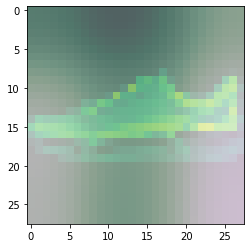

Predicted class = 7, Probabilty = 0.9943193


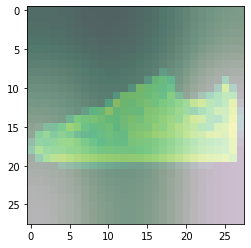

Predicted class = 7, Probabilty = 0.99954623


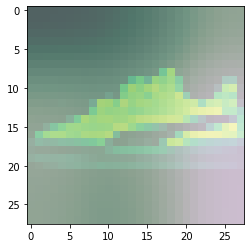

Predicted class = 7, Probabilty = 0.99401075


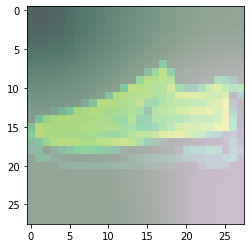

Predicted class = 7, Probabilty = 0.941717


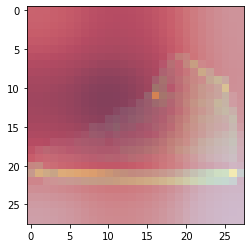

Predicted class = 7, Probabilty = 0.9984016


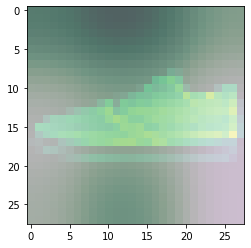

Predicted class = 7, Probabilty = 0.73240364


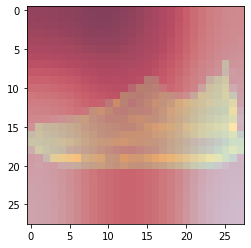

Predicted class = 7, Probabilty = 0.93233293


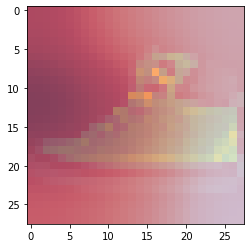

Predicted class = 7, Probabilty = 0.94896084


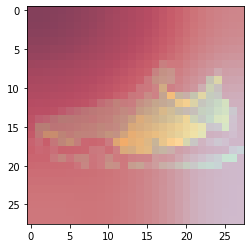

Predicted class = 7, Probabilty = 0.9994106


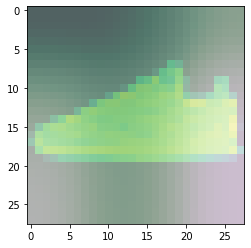

Predicted class = 7, Probabilty = 0.99943477


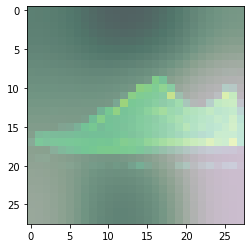

Predicted class = 7, Probabilty = 0.9959766


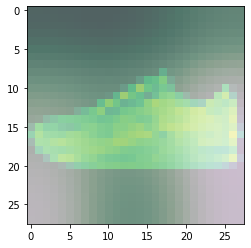

Predicted class = 7, Probabilty = 0.6836985


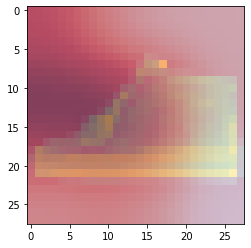

Predicted class = 7, Probabilty = 0.9974148


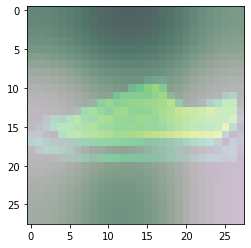

Predicted class = 7, Probabilty = 0.9867491


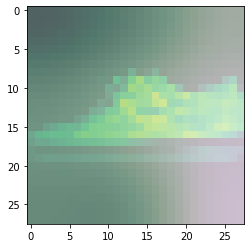

Predicted class = 7, Probabilty = 0.99002564


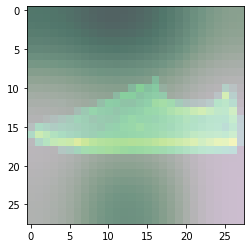

Predicted class = 7, Probabilty = 0.9948866


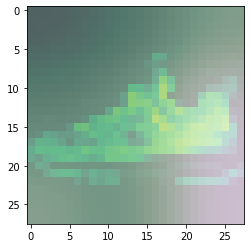

Predicted class = 7, Probabilty = 0.96550435


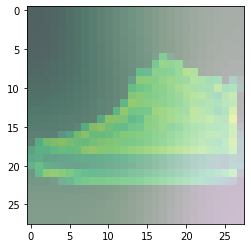

Predicted class = 7, Probabilty = 0.99945873


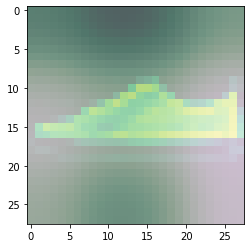

Predicted class = 7, Probabilty = 0.9986841


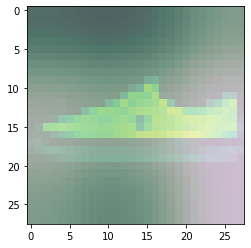

In [ ]:
# For class 8 (handbag), we'll notice that most of the images have dark spots in the middle and right side
# this means that these areas were given less importance when categorizing the image
# the other parts such as the outline or handle contribute more when deciding if an image is a handbag or not
# observe the other classes and see if there are also other common areas that the model uses more in determining the class of the image.

show_maps(desired_class=7, num_maps=20)

## Exampe 2. A very basic Class Activation Map with Cats .vs Dogs Dataset.

We will again practice with CAMs on Cats and Dogs dataset(https://www.tensorflow.org/datasets/catalog/cats_vs_dogs).

In [ ]:
import tensorflow_datasets as tfds
import tensorflow as tf

import keras
from keras.models import Sequential,Model
from keras.layers import Dense,Conv2D,Flatten,MaxPooling2D,GlobalAveragePooling2D

import numpy as np
import matplotlib.pyplot as plt
import scipy as sp
import cv2

Download and prepare the data.

In [ ]:
train_data = tfds.load("cats_vs_dogs", split="train[:80%]", as_supervised=True)
validation_data = tfds.load("cats_vs_dogs", split="train[80%:90%]", as_supervised=True)
test_data = tfds.load("cats_vs_dogs", split="train[-10%:]", as_supervised=True)

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Generating splits...:   0%|          | 0/1 [00:00<?, ? splits/s]

Generating train examples...:   0%|          | 0/23262 [00:00<?, ? examples/s]

Shuffling ~/tensorflow_datasets/cats_vs_dogs/4.0.0.incomplete68EM8T/cats_vs_dogs-train.tfrecord*...:   0%|    …

Dataset cats_vs_dogs downloaded and prepared to ~/tensorflow_datasets/cats_vs_dogs/4.0.0. Subsequent calls will reuse this data.


In [ ]:
# preprocess the images and create batches before feeding it to our model.
def augment_images(image, label):

  # cast to float
  image = tf.cast(image, tf.float32)
  # normalize the pixel values
  image = (image / 255)
  # resize to 300x300
  image = tf.image.resize(image, (300, 300))

  return image, label

# use the utility function above to preprocess the images
augmented_training_data = train_data.map(augment_images)

# shuffle and create batches before training
train_batches = augmented_training_data.shuffle(1024).batch(32)

Build the classifier.

In [ ]:
model = Sequential()
model.add(Conv2D(16, input_shape=(300, 300, 3), kernel_size=(3, 3), 
                 activation="relu", padding="same"))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(32, kernel_size=(3, 3), activation="relu", padding="same"))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(64, kernel_size=(3, 3), activation="relu", padding="same"))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(128, kernel_size=(3, 3), activation="relu", padding="same"))
model.add(GlobalAveragePooling2D())
model.add(Dense(1, activation="sigmoid"))

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 300, 300, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 150, 150, 16)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 150, 150, 32)      4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 75, 75, 32)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 75, 75, 64)        18496     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 37, 37, 64)       0

In [ ]:
# Compiling and Training the model
model.compile(loss="binary_crossentropy",
              metrics=["accuracy"],
              optimizer=tf.keras.optimizers.RMSprop(lr=0.001))

model.fit(train_batches, epochs=25)

Epoch 1/25


/usr/local/lib/python3.8/dist-packages/keras/optimizers/optimizer_v2/rmsprop.py:135: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(RMSprop, self).__init__(name, **kwargs)


582/582 [==============================] - 145s 231ms/step - loss: 0.6675 - accuracy: 0.5916
Epoch 2/25
582/582 [==============================] - 129s 219ms/step - loss: 0.6221 - accuracy: 0.6483
Epoch 3/25
582/582 [==============================] - 125s 212ms/step - loss: 0.5978 - accuracy: 0.6852
Epoch 4/25
582/582 [==============================] - 120s 203ms/step - loss: 0.5767 - accuracy: 0.7003
Epoch 5/25
582/582 [==============================] - 129s 219ms/step - loss: 0.5634 - accuracy: 0.7157
Epoch 6/25
582/582 [==============================] - 134s 228ms/step - loss: 0.5536 - accuracy: 0.7231
Epoch 7/25
582/582 [==============================] - 121s 206ms/step - loss: 0.5466 - accuracy: 0.7283
Epoch 8/25
582/582 [==============================] - 127s 215ms/step - loss: 0.5329 - accuracy: 0.7416
Epoch 9/25
582/582 [==============================] - 129s 219ms/step - loss: 0.5276 - accuracy: 0.7441
Epoch 10/25
582/582 [==============================] - 111s 188ms/step - lo

Building the CAM model.

In [ ]:
# follow the same steps as in example 5 in generating the class activation maps
gap_weights = model.layers[-1].get_weights()[0]
gap_weights.shape

cam_model = Model(inputs=model.input, 
                  outputs=(model.layers[-3].output, 
                           model.layers[-1].output))
cam_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_input (InputLayer)   [(None, 300, 300, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 300, 300, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 150, 150, 16)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 150, 150, 32)      4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 75, 75, 32)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 75, 75, 64)        18496 

In [ ]:
def show_cam(image_value, features, results):
  """
  Displays the class activation map of an image

  Args:
    image_value (tensor) -- preprocessed input image with size 300 x 300
    features (array) -- features of the image, shape (1, 37, 37, 128)
    results (array) -- output of the sigmoid layer
  """

  # there is only one image in the batch so we index as `0`
  features_for_img = features[0]
  prediction = results[0]

  # there is only one unit in the output so we get the weights connected to it
  class_activation_weights = gap_weights[:, 0]

  # upsample to the image size
  class_activation_features = sp.ndimage.zoom(features_for_img, (300/37, 300/37, 1), order=2)

  cam_output = np.dot(class_activation_features, class_activation_weights)

  # visualize the results
  print(f"sigmoid output: {results}")
  print(f"prediction : {'dog' if round(results[0][0]) else 'cat'}")
  plt.figure(figsize=(8,8))
  plt.imshow(cam_output, cmap='jet', alpha=0.5)
  plt.imshow(tf.squeeze(image_value), alpha=0.5)
  plt.show()

Testing the model.

In [ ]:
# download a few images and see how the class activation maps look like.
!wget -O cat1.jpg https://storage.googleapis.com/laurencemoroney-blog.appspot.com/MLColabImages/cat1.jpg
!wget -O cat2.jpg https://storage.googleapis.com/laurencemoroney-blog.appspot.com/MLColabImages/cat2.jpg
!wget -O catanddog.jpg https://storage.googleapis.com/laurencemoroney-blog.appspot.com/MLColabImages/catanddog.jpg
!wget -O dog1.jpg https://storage.googleapis.com/laurencemoroney-blog.appspot.com/MLColabImages/dog1.jpg
!wget -O dog2.jpg https://storage.googleapis.com/laurencemoroney-blog.appspot.com/MLColabImages/dog2.jpg

--2022-12-10 18:49:27--  https://storage.googleapis.com/laurencemoroney-blog.appspot.com/MLColabImages/cat1.jpg
Resolving storage.googleapis.com (storage.googleapis.com)... 173.194.69.128, 108.177.119.128, 108.177.126.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|173.194.69.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 414826 (405K) [image/jpeg]
Saving to: ‘cat1.jpg’

cat1.jpg            100%[===================>] 405.10K  1006KB/s    in 0.4s    

2022-12-10 18:49:27 (1006 KB/s) - ‘cat1.jpg’ saved [414826/414826]

--2022-12-10 18:49:28--  https://storage.googleapis.com/laurencemoroney-blog.appspot.com/MLColabImages/cat2.jpg
Resolving storage.googleapis.com (storage.googleapis.com)... 173.194.69.128, 108.177.119.128, 108.177.126.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|173.194.69.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 599639 (586K) [image/jpeg]
Saving to: ‘cat2.j

1/1 [==============================] - 0s 247ms/step
sigmoid output: [[0.00344015]]
prediction : cat


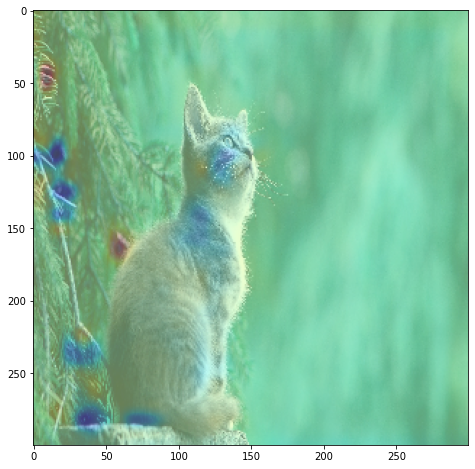

1/1 [==============================] - 1s 690ms/step
sigmoid output: [[0.03427612]]
prediction : cat


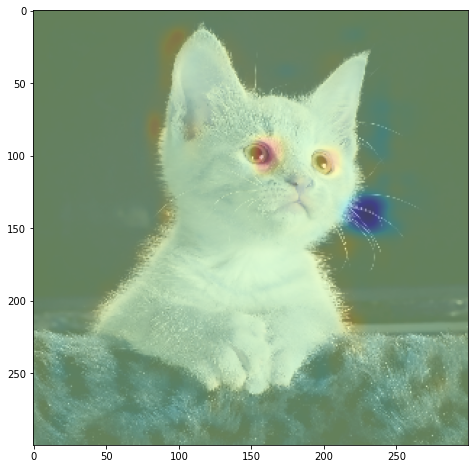

1/1 [==============================] - 0s 118ms/step
sigmoid output: [[0.83614206]]
prediction : dog


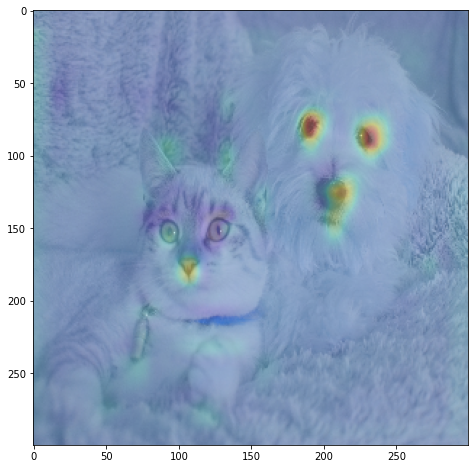

1/1 [==============================] - 0s 19ms/step
sigmoid output: [[0.6191652]]
prediction : dog


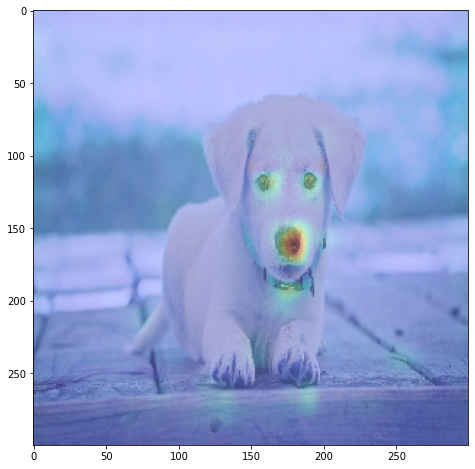

1/1 [==============================] - 0s 15ms/step
sigmoid output: [[0.39822394]]
prediction : cat


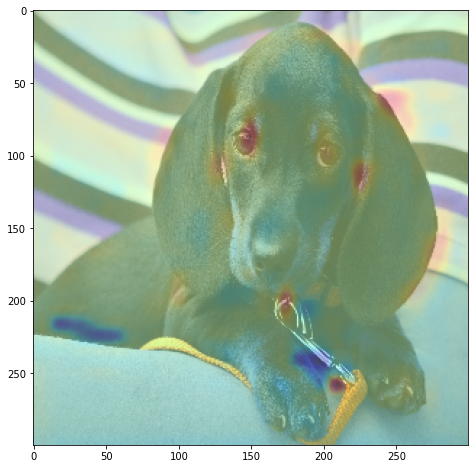

In [ ]:
# utility function to preprocess an image and show the CAM
def convert_and_classify(image):

  # load the image
  img = cv2.imread(image)

  # preprocess the image before feeding it to the model
  img = cv2.resize(img, (300,300)) / 255.0

  # add a batch dimension because the model expects it
  tensor_image = np.expand_dims(img, axis=0)

  # get the features and prediction
  features,results = cam_model.predict(tensor_image)
  
  # generate the CAM
  show_cam(tensor_image, features, results)

convert_and_classify('cat1.jpg')
convert_and_classify('cat2.jpg')
convert_and_classify('catanddog.jpg')
convert_and_classify('dog1.jpg')
convert_and_classify('dog2.jpg')

ground truth: cat
1/1 [==============================] - 0s 16ms/step
sigmoid output: [[0.5920993]]
prediction : dog


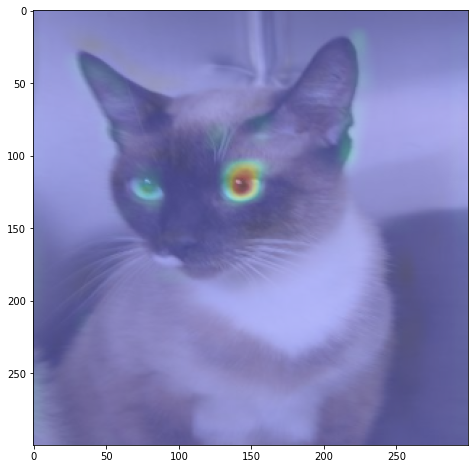

ground truth: dog
1/1 [==============================] - 0s 15ms/step
sigmoid output: [[0.4764534]]
prediction : cat


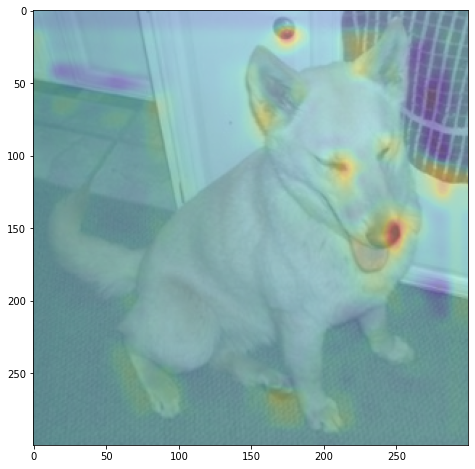

ground truth: dog
1/1 [==============================] - 1s 772ms/step
sigmoid output: [[0.9386779]]
prediction : dog


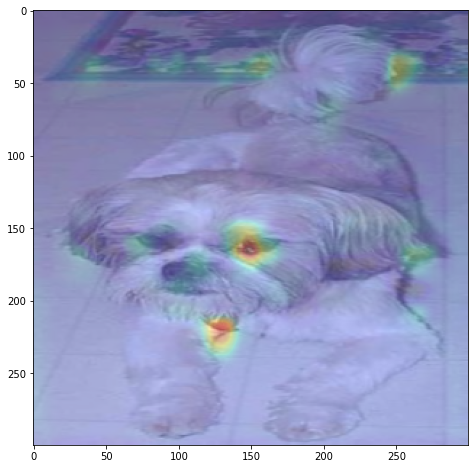

ground truth: cat
1/1 [==============================] - 1s 557ms/step
sigmoid output: [[0.008564]]
prediction : cat


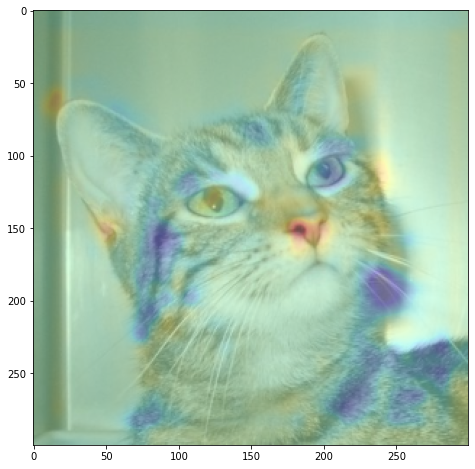

ground truth: cat
1/1 [==============================] - 0s 29ms/step
sigmoid output: [[0.2680557]]
prediction : cat


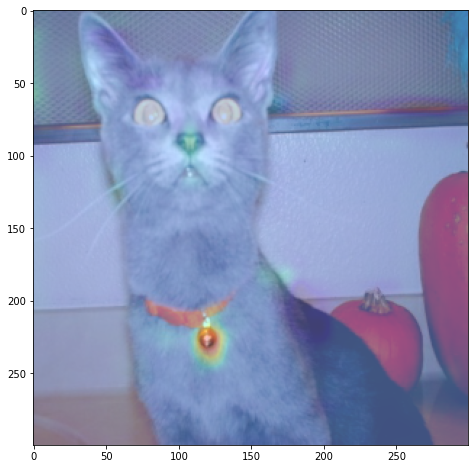

In [ ]:
# try with some of the test images before we make some observations.

# preprocess the test images
augmented_test_data = test_data.map(augment_images)
test_batches = augmented_test_data.batch(1)

for img, lbl in test_batches.take(5):
  print(f"ground truth: {'dog' if lbl else 'cat'}")
  features,results = cam_model.predict(img)
  show_cam(img, features, results)

If your training reached 80% accuracy, you may notice from the images above that the presence of eyes and nose play a big part in determining a dog, while whiskers and a colar mostly point to a cat. Some can be misclassified based on the presence or absence of these features. This tells us that the model is not yet performing optimally and we need to tweak our process (e.g. add more data, train longer, use a different model, etc).

## Example 3. A very simple Saliency Map.

The class activation map helps us to understand a bit more about how we might be able to improve the model by finding an architecture that looks for more than just eyes. One method may be to generate a saliency map, which is a representation of every pixel in the image in a way that makes sense for your particular context. In this sense, it's defined the pixels in the image that end up having an impact on the classification of the image.

In order to compute the saliency of the image with respect to a particular class, we compute the gradients of the loss with respect to the input image. This should tell us how the last value changes with respect to a small change in input image pixels: the gradient tells us how much the categorical loss changes when the input changes. And so it can indicate when certain parts of the input image have a significant effect on the categorical prediction.

In [ ]:
%tensorflow_version 2.x

import tensorflow as tf
import tensorflow_hub as hub
import cv2
import numpy as np
import matplotlib.pyplot as plt

Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.


Build the model.

In [ ]:
# grab the model from Tensorflow hub and append a softmax activation
model = tf.keras.Sequential([
  hub.KerasLayer("https://tfhub.dev/google/tf2-preview/inception_v3/classification/4"),
  tf.keras.layers.Activation("softmax")
])

# build the model base on a specified batch input shape
model.build([None, 300, 300, 3])

Download an image.

In [ ]:
# Get a sample image: a photo of a Siberian Husky that our model will classify

!wget -O image.jpg https://cdn.pixabay.com/photo/2018/02/27/14/11/the-pacific-ocean-3185553_960_720.jpg

# If you want to try the cat, uncomment this line
# !wget -O image.jpg https://cdn.pixabay.com/photo/2018/02/27/14/11/the-pacific-ocean-3185553_960_720.jpg

--2022-12-10 18:50:07--  https://cdn.pixabay.com/photo/2018/02/27/14/11/the-pacific-ocean-3185553_960_720.jpg
Resolving cdn.pixabay.com (cdn.pixabay.com)... 172.64.150.12, 104.18.37.244, 2606:4700:4400::6812:25f4, ...
Connecting to cdn.pixabay.com (cdn.pixabay.com)|172.64.150.12|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 212830 (208K) [binary/octet-stream]
Saving to: ‘image.jpg’

image.jpg           100%[===================>] 207.84K  --.-KB/s    in 0.01s   

2022-12-10 18:50:08 (18.1 MB/s) - ‘image.jpg’ saved [212830/212830]



Preprocess the image.

In [ ]:
# read the image
img = cv2.imread("image.jpg")

# format it to be the RGB colorspace
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# resize to 300x300 and normalize pixel values to be in the range [0, 1]
img = cv2.resize(img, (300, 300)) / 255.0

# add a batch dimension in front
image = np.expand_dims(img, axis=0)

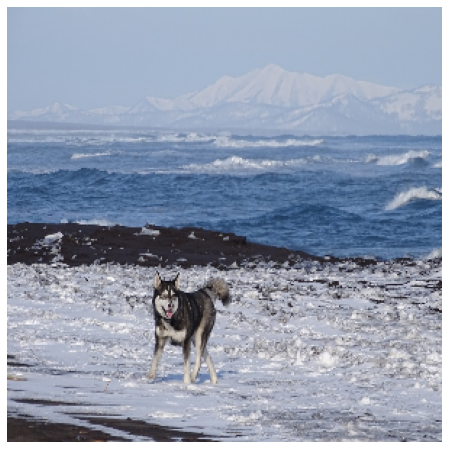

In [ ]:
# preview our input image
plt.figure(figsize=(8, 8))
plt.imshow(img)
plt.axis("off")
plt.show()

Compute Gradients.

In [ ]:
# get the gradients of the loss with respect to the input image pixels. This is the key step to generate the map later.

# Siberian Husky's class ID in ImageNet
class_index = 251

# If you downloaded the cat, use this line instead
#class_index = 282   # Tabby Cat in ImageNet

# number of classes in the model's training data
num_classes = 1001

# convert to one hot representation to match our softmax activation in the model definition
expected_output = tf.one_hot([class_index] * image.shape[0], num_classes)

with tf.GradientTape() as tape:
  # cast image to float
  inputs = tf.cast(image, tf.float32)

  # watch the input pixels
  tape.watch(inputs)

  # generate the predictions
  predictions = model(inputs)

  # get the loss
  loss = tf.keras.losses.categorical_crossentropy(
      expected_output, predictions
  )

# get the gradient with respect to the inputs
gradients = tape.gradient(loss, inputs)

Visualize the results.

In [ ]:
# some postprocessing to generate the saliency maps and overlay it on the image
gradients.shape
gradients

<tf.Tensor: shape=(1, 300, 300, 3), dtype=float32, numpy=
array([[[[ 1.20330963e-03, -2.53209798e-03, -2.08017486e-03],
         [-2.32975464e-03,  1.43121206e-03,  1.97756011e-03],
         [ 3.20743583e-03,  7.58925918e-03,  9.78302583e-03],
         ...,
         [-3.25119752e-03,  4.09066165e-03, -3.92139889e-03],
         [-2.28780298e-03,  2.38693645e-03, -6.63030078e-05],
         [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00]],

        [[ 2.76741548e-03,  1.47424801e-03,  1.28225458e-03],
         [ 2.14963802e-03,  1.05708539e-02,  5.32669341e-03],
         [ 1.11589255e-02,  1.35336891e-02,  1.42323487e-02],
         ...,
         [-2.76324362e-03, -4.00661491e-03, -7.22831767e-03],
         [ 4.23756661e-03,  3.43431416e-03, -1.47245242e-03],
         [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00]],

        [[ 3.07160849e-03,  6.08933158e-03,  5.32273063e-03],
         [ 3.00352089e-03,  1.87982246e-02,  1.42349666e-02],
         [ 7.51402741e-03,  1.10742636e-02

In [ ]:
# reduce the RGB image to grayscale
grayscale_tensor = tf.reduce_sum(tf.abs(gradients), axis=-1)

# normalize the pixel values to be in range [0, 255].
# the max value in the grayscale tensor will be pushed to 255.
# the min value will be push to 0.
normalized_tensor = tf.cast(
    255
    * (grayscale_tensor - tf.reduce_min(grayscale_tensor))
    / (tf.reduce_max(grayscale_tensor) - tf.reduce_min(grayscale_tensor)),
    tf.uint8
)

# remove the channel dimension to make the tensor a 2D tensor
normalized_tensor = tf.squeeze(normalized_tensor)

In [ ]:
# do a little sanity check to see the results of the conversion.

# max and min value in the grayscale tensor
print(np.max(grayscale_tensor[0]))
print(np.min(grayscale_tensor[0]))
print()

# coordinates of the first pixel where the max and min values are located
max_pixel = np.unravel_index(np.argmax(grayscale_tensor[0]), grayscale_tensor[0].shape)
min_pixel = np.unravel_index(np.argmin(grayscale_tensor[0]), grayscale_tensor[0].shape)
print(max_pixel)
print(min_pixel)
print()

# these coordinates should have the max (255) and min (0) value in the normalized tensor
print(normalized_tensor[max_pixel])
print(normalized_tensor[min_pixel])

1.0859315
0.0

(207, 132)
(0, 299)

tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)


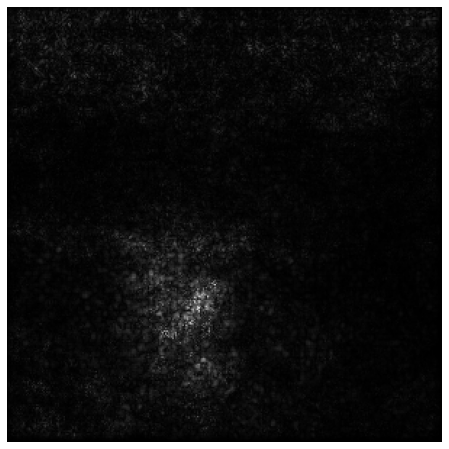

In [ ]:
# let's see what this looks like when plotted. The white pixels show the parts the model focused on when classifying the image.
plt.figure(figsize=(8, 8))
plt.axis('off')
plt.imshow(normalized_tensor, cmap='gray')
plt.show()

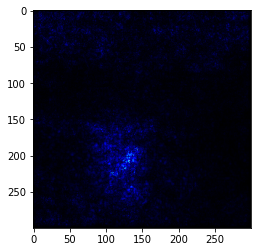

In [ ]:
# let's superimpose the normalized tensor to the input image to get more context
# ee can see that the strong pixels are over the husky and that is a good indication that the model is looking at the correct part of the image
gradient_color = cv2.applyColorMap(normalized_tensor.numpy(), cv2.COLORMAP_HOT)
plt.imshow(gradient_color)

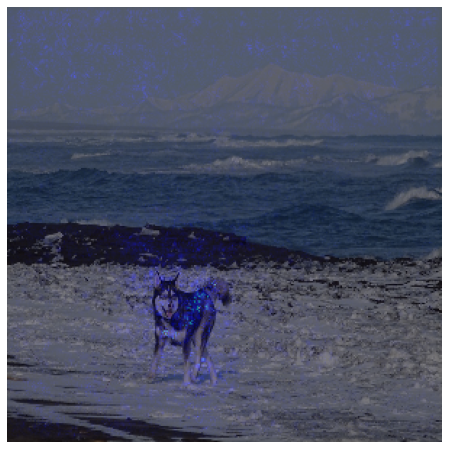

In [ ]:
gradient_color = cv2.applyColorMap(normalized_tensor.numpy(), cv2.COLORMAP_HOT)
gradient_color = gradient_color / 255.0
super_imposed = cv2.addWeighted(img, 0.5, gradient_color, 0.5, 0.0)

plt.figure(figsize=(8, 8))
plt.imshow(super_imposed)
plt.axis("off")
plt.show()

See another example of Saliency Maps here:

https://github.com/GiX7000/coursera-specializations/blob/main/tensorflow-advanced-techniques-specialization-by-deeplearning.ai-April2021/C3-Advanced%20Computer%20Vision%20with%20TensorFlow/C3W4_Assignment_Saliency_Maps.ipynb.

## Example 4. Gradient-weighted class activation maps(GradCAMs) on Cats .vs Dogs Dataset.

This is similar to the CAMs we generated before except that GradCAMs uses gradients instead of the global average pooling weights to weight the activations.

Imports.

In [ ]:
%tensorflow_version 2.x

import warnings 
warnings.filterwarnings("ignore")

import os
import glob
import cv2
from pathlib import Path

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from skimage.io import imread, imsave
from skimage.transform import resize 
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Model
from tensorflow.keras import layers
from tensorflow.keras.applications import vgg16
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.optimizers import SGD, Adam, RMSprop

import tensorflow as tf
import tensorflow.keras.backend as K
import tensorflow_datasets as tfds
import tensorflow_hub as hub

import imgaug as ia
from imgaug import augmenters as iaa

Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.


Download and Prepare the Dataset.

In [ ]:
tfds.disable_progress_bar()

splits = ["train[:80%]", "train[80%:90%]", "train[90%:]"]

# load the dataset given the splits defined above
splits, info = tfds.load("cats_vs_dogs", with_info=True, as_supervised=True, split=splits)

(train_examples, validation_examples, test_examples) = splits

num_examples = info.splits["train"].num_examples
num_classes = info.features["label"].num_classes

In [ ]:
BATCH_SIZE = 32
IMAGE_SIZE = (224, 224)

# resizes the image and normalizes the pixel values
def format_image(image, label):
  image = tf.image.resize(image, IMAGE_SIZE) / 255.0
  return image, label

# prepare batches
train_batches = train_examples.shuffle(num_examples // 4).map(format_image).batch(BATCH_SIZE).prefetch(tf.data.experimental.AUTOTUNE)
validation_batches = validation_examples.map(format_image).batch(BATCH_SIZE).prefetch(tf.data.experimental.AUTOTUNE)
test_batches = test_examples.map(format_image).batch(1)

Modelling.

In [ ]:
def build_model():
  # load the base VGG16 model
  base_model = vgg16.VGG16(input_shape=IMAGE_SIZE + (3,),
                           weights="imagenet",
                           include_top=False)
  
  # freeze the earlier layers
  for layer in base_model.layers[:-4]:
    layer.trainable = False

  # add a GAP layer
  output = layers.GlobalAveragePooling2D()(base_model.output)

  # output has two neurons for the 2 classes (cats and dogs)
  output = layers.Dense(2, activation="softmax")(output)

  # set the inputs and outputs of the model
  model = Model(base_model.input, output)

  # choose the optimizer
  optimizer = tf.keras.optimizers.RMSprop(0.001)  

  # configure the model for training
  model.compile(loss="sparse_categorical_crossentropy",
                optimizer=optimizer,
                metrics=["accuracy"])
  
  # display the summary
  model.summary()

  return model

In [ ]:
model = build_model()

EPOCHS = 3
model.fit(train_batches,
          epochs=EPOCHS,
          validation_data=validation_batches)

58889256/58889256 [==============================] - 4s 0us/step
Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                            

Model Interpretability.

In [ ]:
# select all the layers for which you want visualize the outputs and store it in a list
outputs = [layer.output for layer in model.layers[1:18]]

# Define a new model that generates the above output
vis_model = Model(model.input, outputs)

# store the layer names we are interested in
layer_names = []
for layer in outputs:
  layer_names.append(layer.name.split("/")[0])

print("Layers that will be used for visualization: ")
print(layer_names)

Layers that will be used for visualization: 
['block1_conv1', 'block1_conv2', 'block1_pool', 'block2_conv1', 'block2_conv2', 'block2_pool', 'block3_conv1', 'block3_conv2', 'block3_conv3', 'block3_pool', 'block4_conv1', 'block4_conv2', 'block4_conv3', 'block4_pool', 'block5_conv1', 'block5_conv2', 'block5_conv3']


Class activation maps (GradCAM).

In [ ]:
def get_CAM(processed_image, actual_label, layer_name='block5_conv3'):
  model_grad = Model([model.inputs],
                     [model.get_layer(layer_name).output, model.output])
  
  with tf.GradientTape() as tape:
    conv_output_values, predictions = model_grad(processed_image)

    # watch the conv_output_values
    tape.watch(conv_output_values)

    ## Use binary cross entropy loss
    ## actual_label is 0 if cat, 1 if dog
    # get prediction probability of dog
    # If model does well, 
    # pred_prob should be close to 0 if cat, close to 1 if dog
    pred_prob = predictions[:,1]

    # make sure actual_label is a float, like the rest of the loss calculation
    actual_label = tf.cast(actual_label, dtype=tf.float32)

    # add a tiny value to avoid log of 0
    smoothing = 0.00001

    # Calculate loss as binary cross entropy
    loss = -1 * (actual_label * tf.math.log(pred_prob + smoothing) + (1 - actual_label) * tf.math.log(1 - pred_prob + smoothing))
    print(f"binary loss: {loss}")

  # get the gradient of the loss with respect to the outputs of the last conv layer
  grads_values = tape.gradient(loss, conv_output_values)
  grads_values = K.mean(grads_values, axis=(0, 1, 2))

  conv_output_values = np.squeeze(conv_output_values.numpy())
  grads_values = grads_values.numpy()

  # weight the convolution outputs with the computed gradients
  for i in range(512):
    conv_output_values[:,:,i] *= grads_values[i]
  heatmap = np.mean(conv_output_values, axis=-1)

  heatmap = np.maximum(heatmap, 0)
  heatmap /= heatmap.max()

  del model_grad, conv_output_values, grads_values, loss

  return heatmap

In [ ]:
def show_sample(idx=None):
  # if image index is specified, get that image
  if idx:
    for img, label in test_batches.take(idx):
      sample_image = img[0]
      sample_label = label[0]
  else:
    for img, label in test_batches.shuffle(1000).take(1):
      sample_image = img[0]
      sample_label = label[0]
  
  sample_image_processed = np.expand_dims(sample_image, axis=0)

  activations = vis_model.predict(sample_image_processed)

  pred_label = np.argmax(model.predict(sample_image_processed), axis=-1)[0]

  sample_activation = activations[0][0,:,:,16]

  sample_activation -= sample_activation.mean()
  sample_activation /= sample_activation.std()

  sample_activation *= 255
  sample_activation = np.clip(sample_activation, 0, 255).astype(np.uint8)

  heatmap = get_CAM(sample_image_processed, sample_label)
  heatmap = cv2.resize(heatmap, (sample_image.shape[0], sample_image.shape[1]))
  heatmap = heatmap * 255
  heatmap = np.clip(heatmap, 0, 255).astype(np.uint8)
  heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_HOT)
  converted_image = sample_image.numpy()
  super_imposed_image = cv2.addWeighted(converted_image, 0.8, heatmap.astype("float32"), 2e-3, 0.0)

  f, ax = plt.subplots(2, 2, figsize=(15, 8))

  ax[0, 0].imshow(sample_image)
  ax[0, 0].set_title(f"True label: {sample_label} \n Predicted label: {pred_label}")
  ax[0, 0].axis("off")

  ax[0,1].imshow(sample_activation)
  ax[0,1].set_title("Random feature map")
  ax[0,1].axis('off')
  
  ax[1,0].imshow(heatmap)
  ax[1,0].set_title("Class Activation Map")
  ax[1,0].axis('off')
  
  ax[1,1].imshow(super_imposed_image)
  ax[1,1].set_title("Activation map superimposed")
  ax[1,1].axis('off')

  plt.tight_layout()
  plt.show()

  return activations

Visualize the results.

1/1 [==============================] - 0s 118ms/step
binary loss: [0.01737256]


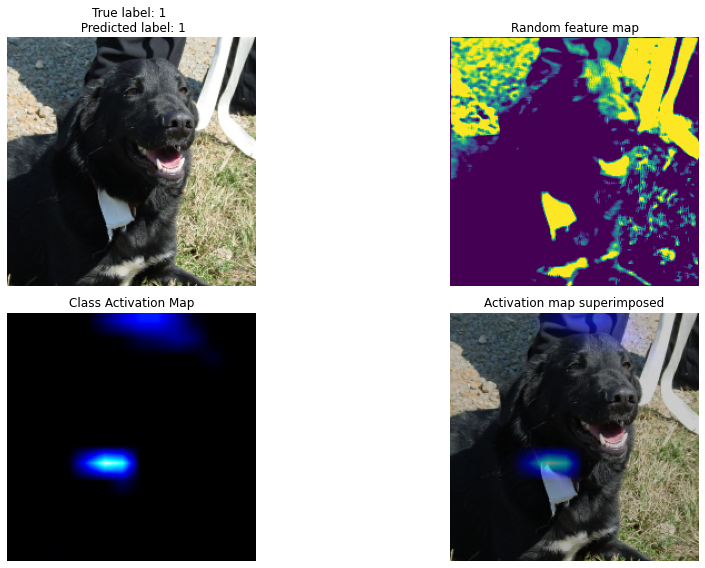

In [ ]:
# Choose an image index to show, or leave it as None to get a random image
activations = show_sample(idx=None)

Intermediate activations of layers.

In [ ]:
# use the utility function below to visualize the activations in the intermediate layers you defined earlier
# this plots the feature side by side for each convolution layer starting from the earliest layer all the way to the final convolution layer
def visualize_intermediate_activations(layer_names, activations):
    assert len(layer_names)==len(activations), "Make sure layers and activation values match"
    images_per_row=16
    
    for layer_name, layer_activation in zip(layer_names, activations):
        nb_features = layer_activation.shape[-1]
        size= layer_activation.shape[1]

        nb_cols = nb_features // images_per_row
        grid = np.zeros((size*nb_cols, size*images_per_row))

        for col in range(nb_cols):
            for row in range(images_per_row):
                feature_map = layer_activation[0,:,:,col*images_per_row + row]
                feature_map -= feature_map.mean()
                feature_map /= feature_map.std()
                feature_map *=255
                feature_map = np.clip(feature_map, 0, 255).astype(np.uint8)

                grid[col*size:(col+1)*size, row*size:(row+1)*size] = feature_map

        scale = 1./size
        plt.figure(figsize=(scale*grid.shape[1], scale*grid.shape[0]))
        plt.title(layer_name)
        plt.grid(False)
        plt.axis('off')
        plt.imshow(grid, aspect='auto', cmap='viridis')
    plt.show()


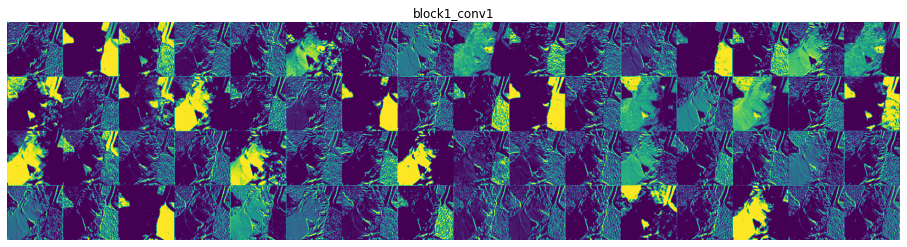

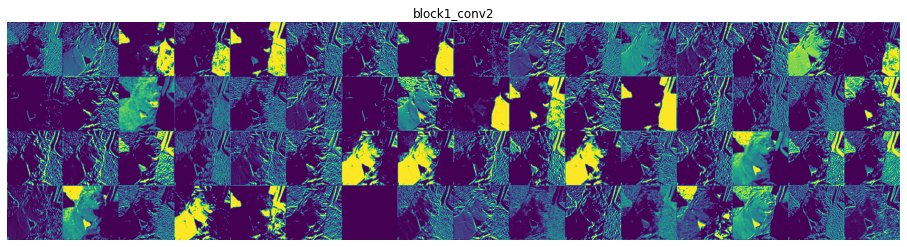

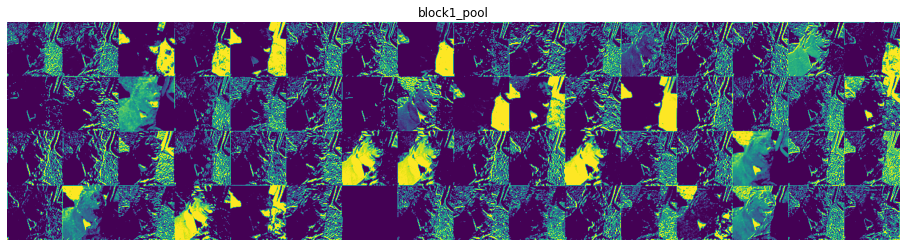

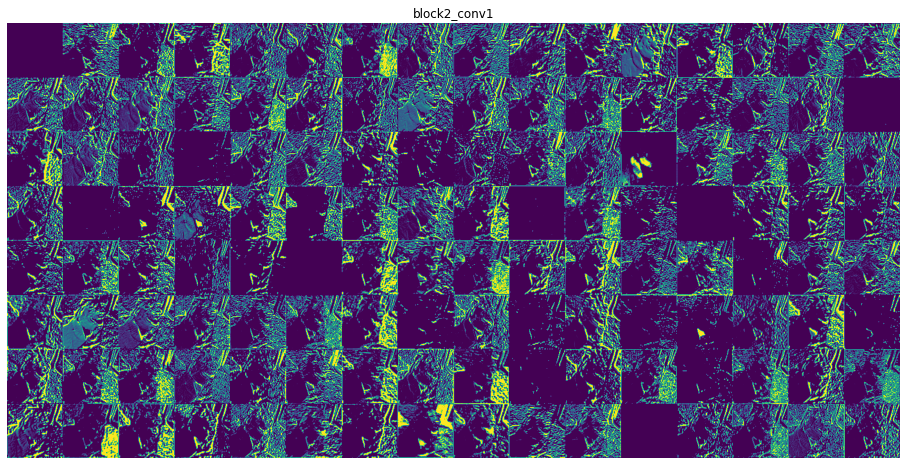

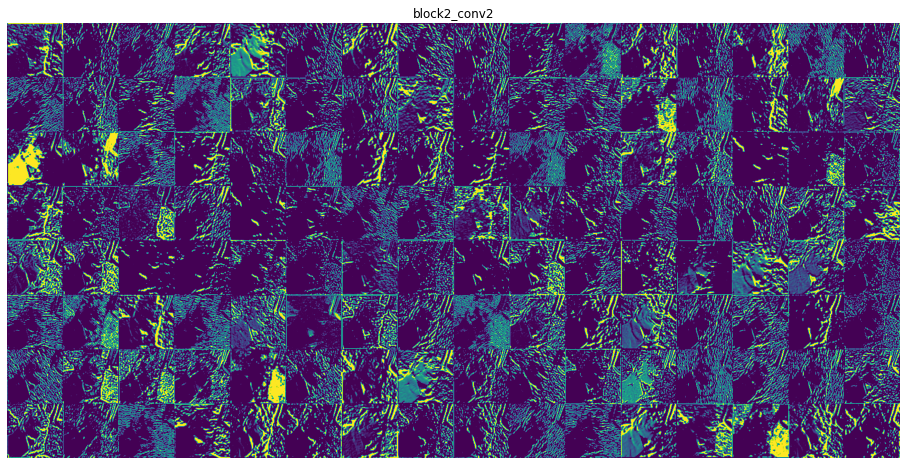

...

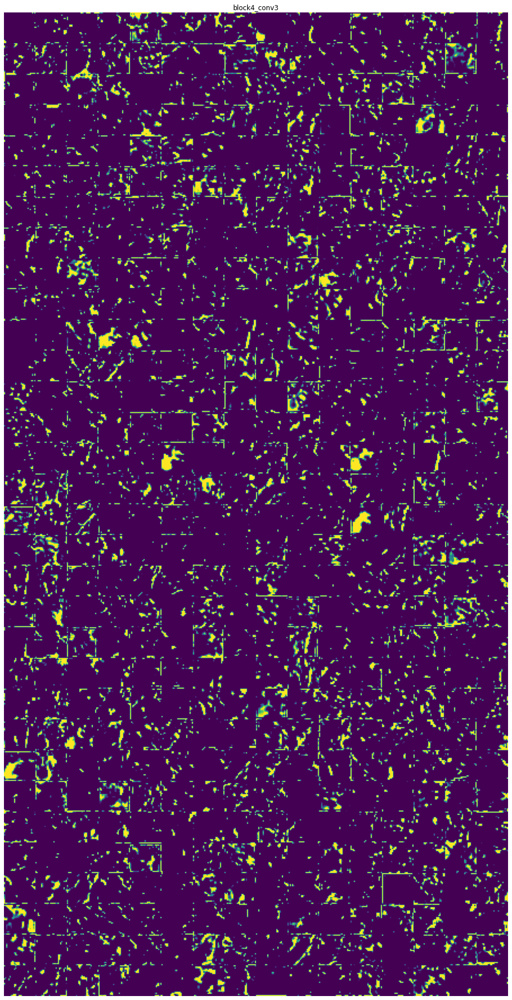

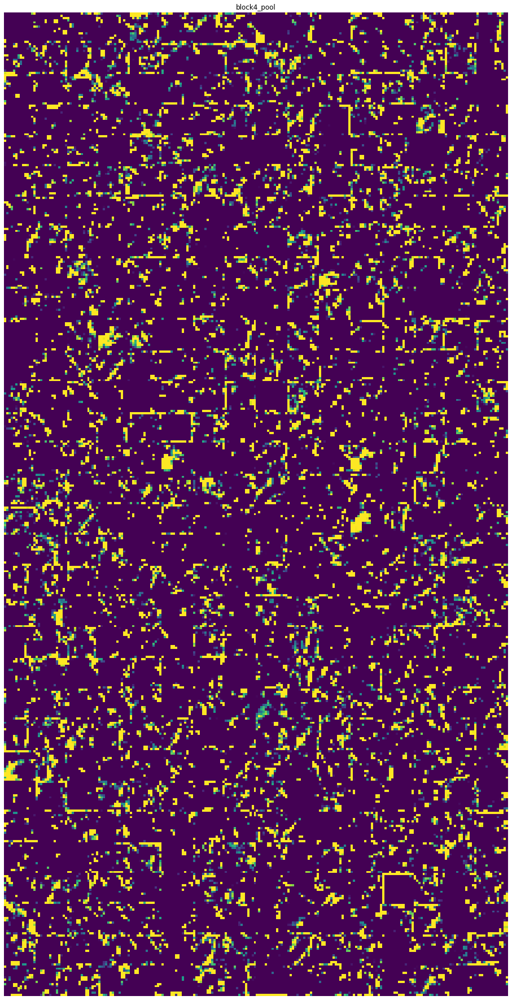

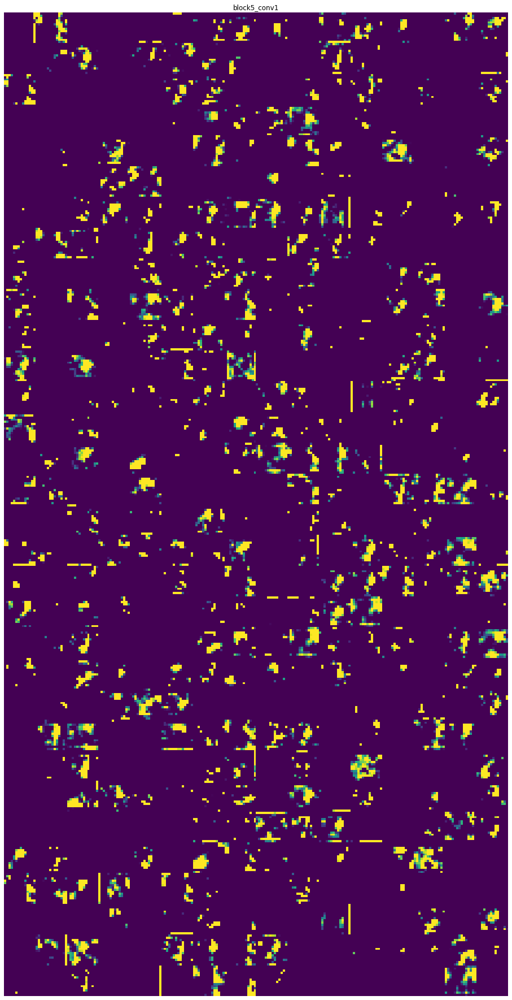

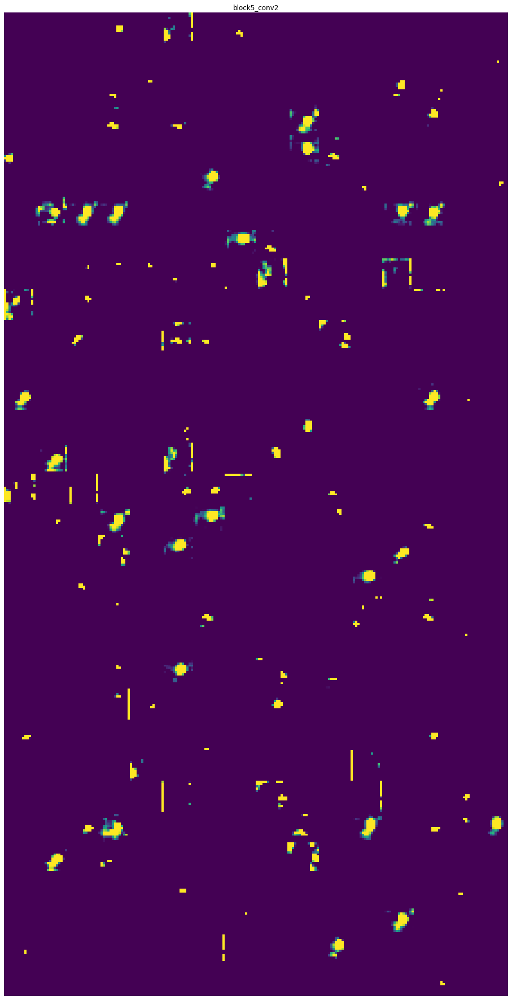

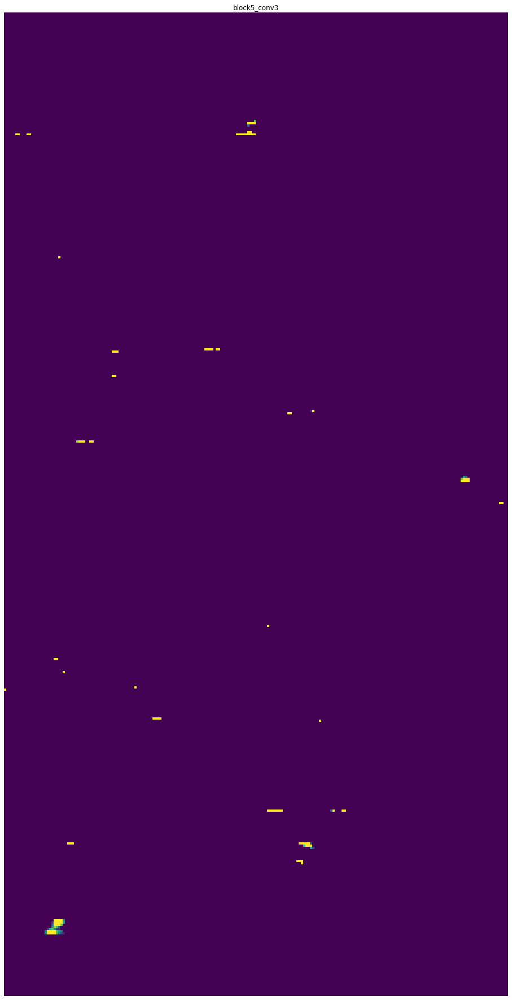

In [ ]:
visualize_intermediate_activations(activations=activations, 
                                   layer_names=layer_names)

If you scroll all the way down to see the outputs of the final conv layer, you'll see that there are very few active features and these are mostly located in the face of the cat. This is the region of the image that your model looks at when determining the class.